---
title: "Urban Heat (Temperature), NDVI, and Cluster Analysis"
format:
    html:
        toc: false
        page-layout: full
        code-fold: true
        code-tools: true
execute:
    echo: false
---        

In [34]:
from matplotlib import pyplot as plt
import numpy as np
import pandas as pd
import geopandas as gpd
import requests
import hvplot.pandas

np.random.seed(42)

In [35]:
import intake
import rasterio as rio
import xarray as xr
import hvplot.xarray
import hvplot.pandas
import holoviews as hv
import geoviews as gv
from geoviews.tile_sources import EsriImagery
import rioxarray 
import rasterio

#

## Introduction

Temperature and NDVI are two major factors when considering Urban Heat Index
Selection of Landsat 7 Data for Consistency with Census Intervals
The Urban Heat Index (UHI) analysis in Hong Kong heavily relies on two primary factors: temperature and the Normalized Difference Vegetation Index (NDVI). To align the satellite data with census intervals, we've opted for data from Landsat 7 ETM+. The choice of Landsat 7, despite the availability of Landsat 8 and 9, is dictated by the need for consistency with the census data from the Hong Kong government and ESRI Hong Kong, which are available every five years. The most recent census data was from 2021, necessitating the use of data from 2011 and 2016 as well. Given that Landsat 8 started operating in 2013, it wouldn't cover the entire period corresponding to our census data, leading to the decision to utilize Landsat 7's data for a comprehensive analysis.

## Methodology for Accurate Data Retrieval and Processing

For ensuring accuracy, our approach involved creating a mosaic composite raster image from Google Earth Engine, filtered for the entire year. This process was repeated for each year from 2011 to 2021 to extract the annual mean of temperature and NDVI for each pixel. The most challenging aspect of this section was the calibration of the data retrieved from Google Earth Engine. We encountered numerous difficulties in calibrating the band data. For instance, there were times when the NDVI worked correct (in the range) on Google Earth Engine but failed in Python. Similarly, issues were faced with the land surface temperature data. After countless attempts and explorations, we discovered a calculation method from an academic paper that provided a more refined approach. This method allowed for the conversion of digital numbers, surface reflectance, top of the atmosphere reflectance, top brightness temperature, and land surface temperature in a more accurate way.

(GEE link:https://code.earthengine.google.com/a1c8085a46f0c89f1d82f0cfcfabacd8) 

Reference: Ermida, S.L., Soares, P., Mantas, V., Göttsche, F.-M., Trigo, I.F., 2020. Google Earth Engine open-source code for Land Surface Temperature estimation from the Landsat series.
Remote Sensing, 12 (9), 1471; https://doi.org/10.3390/rs12091471

### Load the Lansat 7 2011 Mosaic Image

In [3]:
# Use Xarray package to open hk_2011
hk_2011 = xr.open_dataset("./data/Landsat7_LST_HongKong_2011.tif", engine="rasterio")

hk_2011

<xarray.Dataset>
Dimensions:      (band: 16, x: 2503, y: 1783)
Coordinates:
  * band         (band) int64 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16
  * x            (x) float64 113.8 113.8 113.8 113.8 ... 114.5 114.5 114.5 114.5
  * y            (y) float64 22.57 22.57 22.57 22.57 ... 22.09 22.09 22.09 22.09
    spatial_ref  int64 ...
Data variables:
    band_data    (band, y, x) float32 ...

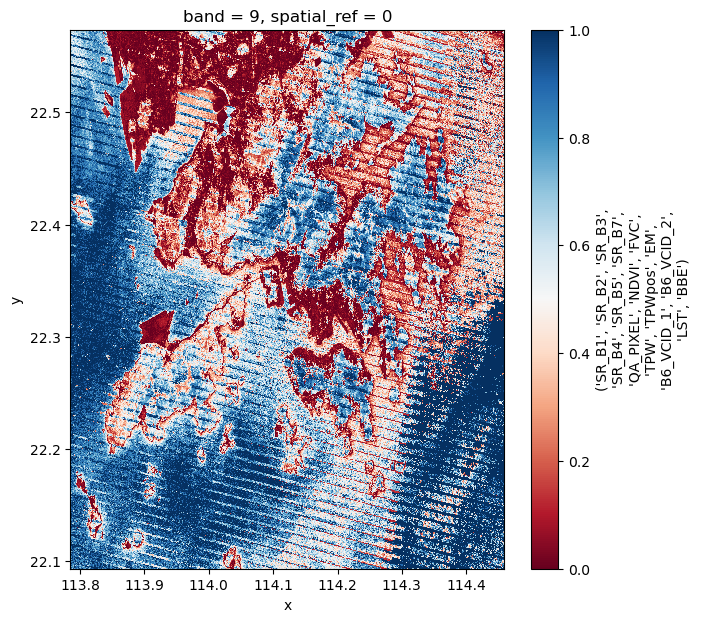

In [73]:
# We have to speify the x and y here otherwise, the full image would rotate
# hk_2011_plot = hk_2011.hvplot.image('x', 'y', width=700, height=700, cmap="RdBu")
import matplotlib.pyplot as plt

band_9 = hk_2011.band_data.isel(band=8)

# Plotting using imshow
band_9_plot = band_9.plot.imshow(cmap='RdBu', figsize=(7, 7))

# Display the plot
plt.show()



#### Read the Hong Kong District Data from ArcGIS geojson

In [5]:
# Read Hong Kong District Data
district_url = (
    'https://services3.arcgis.com/6j1KwZfY2fZrfNMR/arcgis/rest/services/Hong_Kong_18_Districts/FeatureServer/0/query?outFields=*&where=1%3D1&f=geojson'
)
hk_limit = gpd.read_file(district_url)
type(hk_limit)

geopandas.geodataframe.GeoDataFrame

#### We decided to use EPSG: 4326 since the CRS of Landsat 7 Data's is EPSG= 4326

In [6]:
# Calculate the total bounds of the hk_limit polygons
xmin, ymin, xmax, ymax = hk_limit.total_bounds
xmin, ymin, xmax, ymax

(113.835066606914, 22.153344109236, 114.441993257571, 22.5619493489016)

#### Trim our precious Raster Data to the Hong Kong Boundary

In [7]:
hk_subset = hk_2011.sel(x=slice(xmin, xmax), y=slice(ymax, ymin))
hk_subset = hk_subset.compute()

hk_subset

<xarray.Dataset>
Dimensions:      (band: 16, x: 2252, y: 1516)
Coordinates:
  * band         (band) int64 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16
  * x            (x) float64 113.8 113.8 113.8 113.8 ... 114.4 114.4 114.4 114.4
  * y            (y) float64 22.56 22.56 22.56 22.56 ... 22.15 22.15 22.15 22.15
    spatial_ref  int64 0
Data variables:
    band_data    (band, y, x) float32 1.004e+04 9.852e+03 ... 0.9903 0.9901

#### Raster image combined with City limits

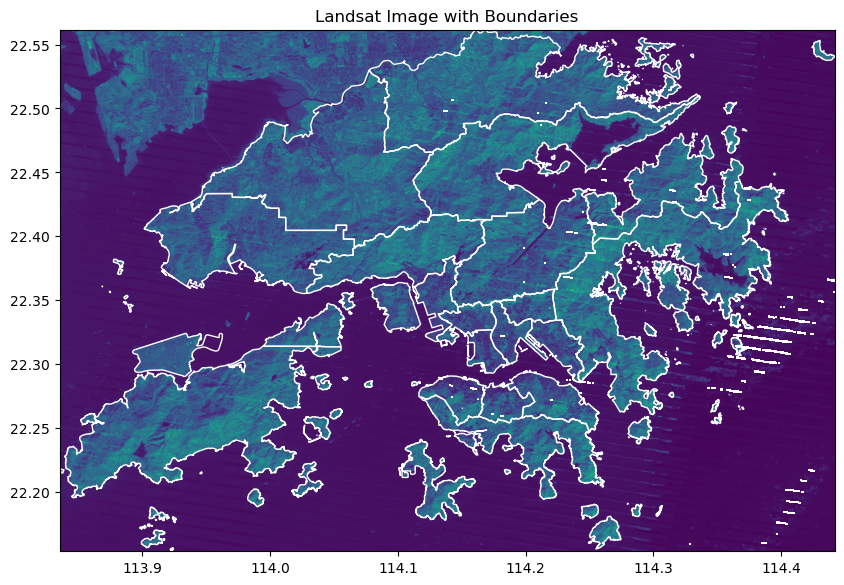

In [76]:
# City limits plot
# limits_plot = hk_limit.hvplot.polygons(
#     line_color="white", alpha=0, line_alpha=1, crs=4326, geo=True
# )

# # Landsat plot
# landsat_plot = hk_subset.sel(band=4).hvplot.image(
#     x="x",
#     y="y",
#     rasterize=True,
#     cmap="viridis",
#     frame_width=500,
#     frame_height=500,
#     geo=True,
#     crs=4326,
# )

# # Combined
# landsat_plot * limits_plot
import matplotlib.pyplot as plt

# Plotting polygons from hk_limit GeoDataFrame
fig, ax = plt.subplots(figsize=(10, 10))  # Adjust the size as needed
hk_limit.plot(ax=ax, edgecolor='white', facecolor='none', linewidth=1)

# Select band 4 DataArray from hk_subset
band_4 = hk_subset.band_data.sel(band=4)

imshow_extent = [hk_subset.x.min(), hk_subset.x.max(), hk_subset.y.min(), hk_subset.y.max()]
ax.imshow(band_4, extent=imshow_extent, cmap='viridis', origin='upper')

# Add additional plot formatting as needed
ax.set_title('Landsat Image with Boundaries')
plt.show()


#### Calculate the NDVI using Near Infrared Band and Red Band.

In [78]:
NIR_2011 = hk_subset.sel(band=4)
RED_2011 = hk_subset.sel(band=3)

# Calculate the NDVI
NDVI_2011 = (NIR_2011 - RED_2011) / (NIR_2011 + RED_2011)
NDVI_2011 = NDVI_2011.where(NDVI_2011 < np.inf)

NDVI_2011

<xarray.Dataset>
Dimensions:      (y: 1516, x: 2252)
Coordinates:
  * x            (x) float64 113.8 113.8 113.8 113.8 ... 114.4 114.4 114.4 114.4
  * y            (y) float64 22.56 22.56 22.56 22.56 ... 22.15 22.15 22.15 22.15
    spatial_ref  int64 0
Data variables:
    band_data    (y, x) float32 -0.0636 -0.06632 -0.06632 ... -0.03526 -0.02509

#### Plot the 2011 mean NDVI with city limits

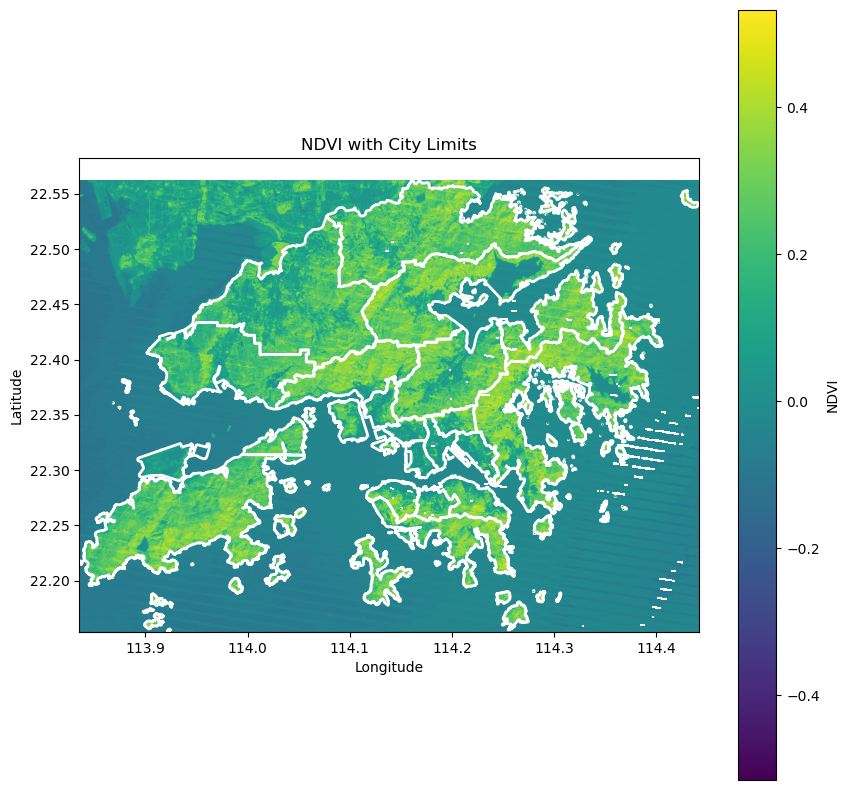

In [79]:
# # NEW: Use datashader to plot the NDVI
# p = NDVI_2011.hvplot.image(
#     x="x",
#     y="y",
#     geo=True,
#     crs=4326,
#     datashade=True, # NEW: USE DATASHADER
#     project=True, # NEW: PROJECT THE DATA BEFORE PLOTTING
#     frame_height=500,
#     frame_width=500,
#     cmap="viridis",
# )

# # NEW: Use a transparent rasterized version of the plot for hover text
# # No hover text available with datashaded images so we can use the rasterized version
# p_hover = NDVI_2011.hvplot(
#     x="x",
#     y="y",
#     crs=4326,
#     geo=True,
#     rasterize=True,
#     frame_height=500,
#     frame_width=500,
#     alpha=0, # SET ALPHA=0 TO MAKE THIS TRANSPARENT
#     colorbar=False,
# )

# # City limits
# limits_plot = hk_limit.hvplot.polygons(
#     geo=True, crs=4326, line_color="white", line_width=2, alpha=0, line_alpha=1
# )


# p * p_hover * limits_plot
# hvplot sucks!
fig, ax = plt.subplots(figsize=(10, 10))
ndvi_img = ax.imshow(NDVI_2011.band_data, extent=[NDVI_2011.x.min(), NDVI_2011.x.max(), 
                                         NDVI_2011.y.min(), NDVI_2011.y.max()], 
                     cmap='viridis', origin='upper')

# Add a colorbar for NDVI
plt.colorbar(ndvi_img, ax=ax, orientation='vertical', label='NDVI')

hk_limit.plot(ax=ax, edgecolor='white', facecolor='none', linewidth=2)

# Set plot title and labels as needed
ax.set_title('NDVI with City Limits')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')

plt.show()


#### The Band 15 is the calibrated Land Surface Temperature Band in Kelvin, so we have to subtract 273.15 from the original band data to convert it to Celsius

In [11]:
band6 = hk_subset.sel(band=15)

# Convert from Kelvin to Celsius
band6_celsius = band6-273.15
band6_celsius.head()

<xarray.Dataset>
Dimensions:      (x: 5, y: 5)
Coordinates:
    band         int64 15
  * x            (x) float64 113.8 113.8 113.8 113.8 113.8
  * y            (y) float64 22.56 22.56 22.56 22.56 22.56
    spatial_ref  int64 0
Data variables:
    band_data    (y, x) float32 19.86 19.86 19.86 20.4 ... 17.04 17.04 17.04

In [12]:
band_6 = band6_celsius.copy()
band_6.mean()

<xarray.Dataset>
Dimensions:      ()
Coordinates:
    band         int64 15
    spatial_ref  int64 0
Data variables:
    band_data    float32 20.17

In [17]:
import rioxarray

In [18]:
band_6.rio.to_raster("./hk2011_temp.tif")
NDVI_2011.rio.to_raster("./hk2011_ndvi.tif")

In [19]:
from rasterstats import zonal_stats
import rasterio as rio
hk2011_temp = rio.open('./hk2011_temp.tif')
hk2011_ndvi = rio.open('./hk2011_ndvi.tif')


#### Using Zonal Statistics to calculate the mean temperature and NDVI for each Hong Kong District

In [81]:
hk2011_stats_temp = zonal_stats(hk_limit.to_crs(epsg=4326), "./hk2011_temp.tif")
hk2011_stats_ndvi = zonal_stats(hk_limit.to_crs(epsg=4326), "./hk2011_ndvi.tif")
# Converts stats to a dataframe
hk2011_stats_temp = pd.DataFrame(hk2011_stats_temp)
hk2011_stats_ndvi = pd.DataFrame(hk2011_stats_ndvi)
hk_limit["mean_temp_2011"] = hk2011_stats_temp['mean']
hk_limit["mean_ndvi_2011"] = hk2011_stats_ndvi['mean']
hk_limit = hk_limit.drop('max_temp_2011', axis=1)
hk_limit.head(n=10)

,OBJECTID,ID,CNAME,CNAME_S,ENAME,Shape__Area,Shape__Length,geometry,mean_ndvi_2011,max_temp_2016,mean_ndvi_2016,mean_temp_2011
0,1,1,黃大仙區,黄大仙区,WONG TAI SIN,1.092784e+07,17995.640782,"POLYGON ((114.17942 22.34905, 114.17946 22.349...",0.211102,24.699992,0.234139,20.704102
1,2,6,九龍城區,九龙城区,KOWLOON CITY,1.184286e+07,31834.409404,"MULTIPOLYGON (((114.17700 22.34904, 114.17702 ...",0.090806,26.748404,0.097568,23.277648
2,3,7,觀塘區,观塘区,KWUN TONG,1.322124e+07,25496.700164,"POLYGON ((114.24371 22.28620, 114.24370 22.286...",0.121019,26.426119,0.136822,22.402509
3,4,8,西貢區,西贡区,SAI KUNG,1.602944e+08,365545.476363,"MULTIPOLYGON (((114.22112 22.35318, 114.22114 ...",0.262977,24.956479,0.282872,21.255087
4,5,11,北區,北区,NORTH,1.619184e+08,192815.532996,"MULTIPOLYGON (((114.33576 22.51003, 114.33576 ...",0.251814,22.677352,0.271825,19.671759
5,6,13,中西區,中西区,CENTRAL & WESTERN,1.460458e+07,26733.700864,"MULTIPOLYGON (((114.14562 22.29045, 114.14990 ...",0.194695,23.794897,0.199246,18.948752
6,7,14,灣仔區,湾仔区,WAN CHAI,1.161490e+07,19548.075298,"MULTIPOLYGON (((114.20012 22.27387, 114.20047 ...",0.191913,24.292477,0.201838,19.608638
7,8,15,東區,东区,EASTERN,2.184211e+07,36188.456666,"POLYGON ((114.24738 22.25339, 114.24733 22.253...",0.213661,23.827175,0.236692,19.821950
8,9,17,屯門區,屯门区,TUEN MUN,9.921091e+07,99074.932441,"MULTIPOLYGON (((113.93745 22.42638, 113.93765 ...",0.188711,25.061902,0.221932,20.773037
9,10,18,元朗區,元朗区,YUEN LONG,1.648768e+08,91328.856191,"MULTIPOLYGON (((113.93832 22.42696, 113.93843 ...",0.196683,23.764657,0.213754,20.540728


#### Mean 2011 annual temperature for each district

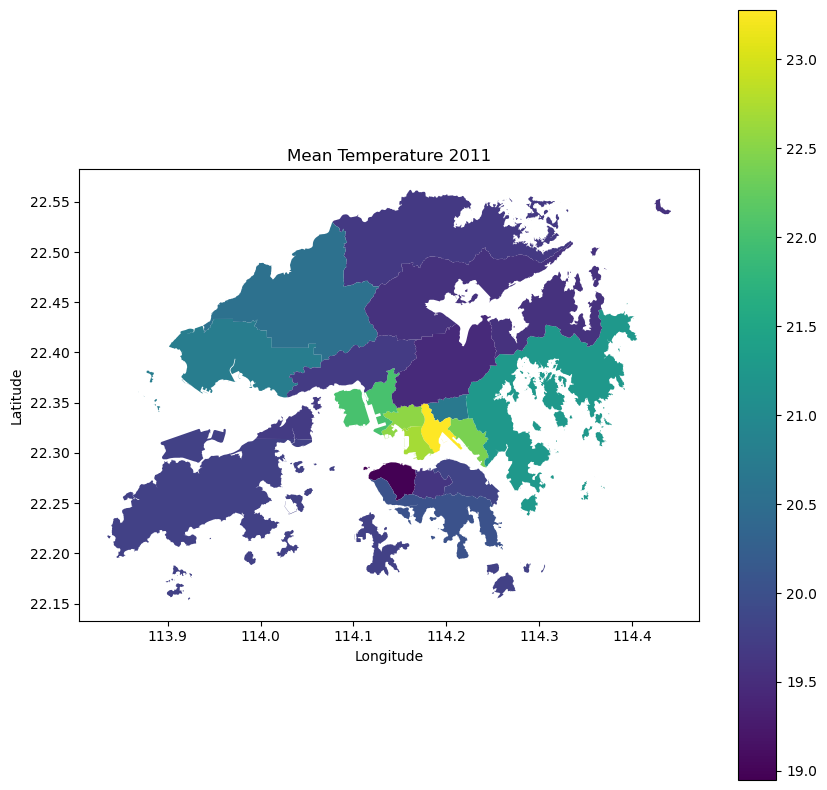

In [84]:
# plot_temp_2011 = hk_limit.hvplot(geo=True,  # Use geographic coordinates
#                        c='max_temp_2011',  # Use the mean temperature column for coloring
#                        hover_cols=['ENAME'],  # Display district names on hover
#                        cmap='viridis',  # Choose a colormap
#                        colorbar=True,  # Display a colorbar
#                        frame_width=500)  # Set the width of the frame
# plot_temp_2011
fig, ax = plt.subplots(figsize=(10, 10))
plot_temp_2011 = hk_limit.plot(column='mean_temp_2011', cmap='viridis', 
                               legend=True, ax=ax)
ax.set_title('Mean Temperature 2011')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')

plt.show()

#### Mean annual NDVI for each district

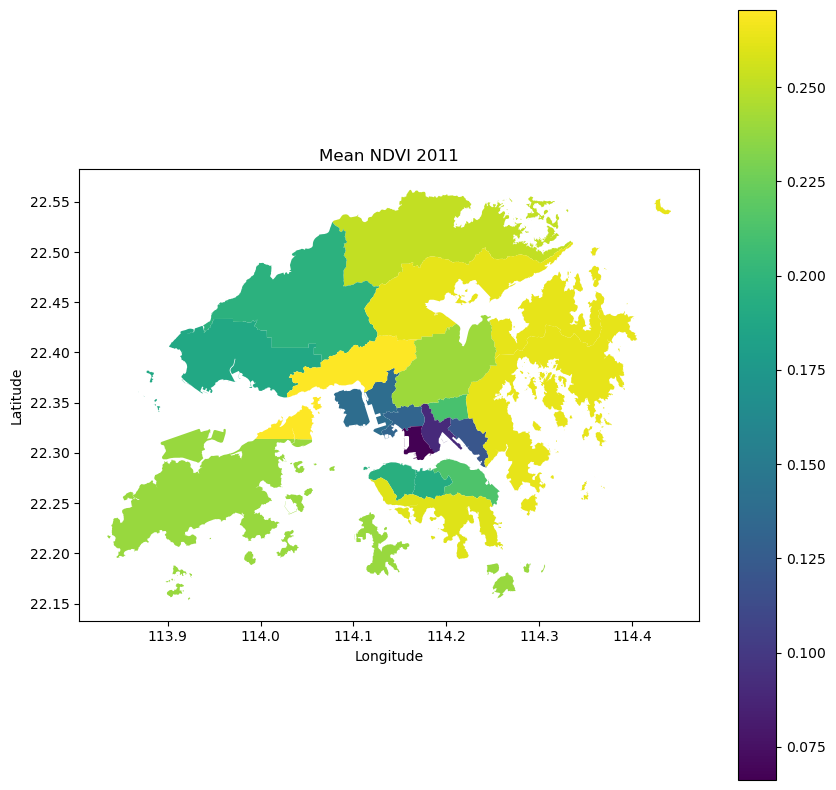

In [85]:
# plot_ndvi_2011 = hk_limit.hvplot(geo=True,  # Use geographic coordinates
#                        c='mean_ndvi_2011',  # Use the mean temperature column for coloring
#                        hover_cols=['ENAME'],  # Display district names on hover
#                        cmap='RdYlGn',  # Choose a colormap
#                        colorbar=True,  # Display a colorbar
#                        frame_width=500)  # Set the width of the frame

# # Show the plot
# plot_ndvi_2011
fig, ax = plt.subplots(figsize=(10, 10))
plot_temp_2011 = hk_limit.plot(column='mean_ndvi_2011', cmap='viridis', 
                               legend=True, ax=ax)
ax.set_title('Mean NDVI 2011')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')

plt.show()

# 2016 version

In [23]:
hk_2016 = xr.open_dataset("./data/Landsat7_LST_HongKong_2016.tif", engine="rasterio")

hk_2016

<xarray.Dataset>
Dimensions:      (band: 16, x: 2503, y: 1783)
Coordinates:
  * band         (band) int64 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16
  * x            (x) float64 113.8 113.8 113.8 113.8 ... 114.5 114.5 114.5 114.5
  * y            (y) float64 22.57 22.57 22.57 22.57 ... 22.09 22.09 22.09 22.09
    spatial_ref  int64 ...
Data variables:
    band_data    (band, y, x) float32 ...

In [24]:
hk_2016_plot = hk_2016.hvplot.image('x', 'y', width=700, height=700, cmap="viridis")


#hk_2016_plot

:DynamicMap   [band]
   :Image   [x,y]   (band_data)

In [25]:
hk_subset_2016 = hk_2016.sel(x=slice(xmin, xmax), y=slice(ymax, ymin))
hk_subset_2016 = hk_subset_2016.compute()

hk_subset_2016

<xarray.Dataset>
Dimensions:      (band: 16, x: 2252, y: 1516)
Coordinates:
  * band         (band) int64 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16
  * x            (x) float64 113.8 113.8 113.8 113.8 ... 114.4 114.4 114.4 114.4
  * y            (y) float64 22.56 22.56 22.56 22.56 ... 22.15 22.15 22.15 22.15
    spatial_ref  int64 0
Data variables:
    band_data    (band, y, x) float32 1.061e+04 1.032e+04 ... 0.9894 0.9897

In [36]:
NIR_2016 = hk_subset_2016.sel(band=4)
RED_2016 = hk_subset_2016.sel(band=3)

# Calculate the NDVI
NDVI_2016 = (NIR_2016 - RED_2016) / (NIR_2016 + RED_2016)
NDVI_2016 = NDVI_2016.where(NDVI_2016 < np.inf)

NDVI_2016.mean()


<xarray.Dataset>
Dimensions:      ()
Coordinates:
    spatial_ref  int64 0
Data variables:
    band_data    float32 0.09237

In [37]:
band6_2016 = hk_subset_2016.sel(band=15)-273.15

# Convert from Kelvin to Celsius

band6_2016.mean()

<xarray.Dataset>
Dimensions:      ()
Coordinates:
    band         int64 15
    spatial_ref  int64 0
Data variables:
    band_data    float32 23.15

In [28]:
# NEW: Use datashader to plot the NDVI
p_2016 = NDVI_2016.hvplot.image(
    x="x",
    y="y",
    geo=True,
    crs=4326,
    datashade=True, # NEW: USE DATASHADER
    project=True, # NEW: PROJECT THE DATA BEFORE PLOTTING
    frame_height=500,
    frame_width=500,
    cmap="viridis",
)

# NEW: Use a transparent rasterized version of the plot for hover text
# No hover text available with datashaded images so we can use the rasterized version
p_hover_2016 = NDVI_2016.hvplot(
    x="x",
    y="y",
    crs=4326,
    geo=True,
    rasterize=True,
    frame_height=500,
    frame_width=500,
    alpha=0, # SET ALPHA=0 TO MAKE THIS TRANSPARENT
    colorbar=False,
)

# City limits
limits_plot = hk_limit.hvplot.polygons(
    geo=True, crs=4326, line_color="white", line_width=2, alpha=0, line_alpha=1
)


# p_2016 * p_hover_2016 * limits_plot

:DynamicMap   []
   :Overlay
      .RGB.I      :RGB   [x,y]   (R,G,B,A)
      .Image.I    :Image   [x,y]   (band_data)
      .Polygons.I :Polygons   [Longitude,Latitude]

In [82]:
band6_2016.rio.to_raster("./hk2016_temp.tif")
NDVI_2016.rio.to_raster("./hk2016_ndvi.tif")

hk2016_temp = rio.open('./hk2016_temp.tif')
hk2016_ndvi = rio.open('./hk2016_ndvi.tif')
hk2016_stats_temp = zonal_stats(hk_limit.to_crs(epsg=4326), "./hk2016_temp.tif")
hk2016_stats_ndvi = zonal_stats(hk_limit.to_crs(epsg=4326), "./hk2016_ndvi.tif")
# Converts stats to a dataframe
hk2016_stats_temp = pd.DataFrame(hk2016_stats_temp)
hk2016_stats_ndvi = pd.DataFrame(hk2016_stats_ndvi)
hk_limit["mean_temp_2016"] = hk2016_stats_temp['mean']
hk_limit["mean_ndvi_2016"] = hk2016_stats_ndvi['mean']
hk_limit = hk_limit.drop('max_temp_2016', axis=1)
hk_limit.head(n=10)

,OBJECTID,ID,CNAME,CNAME_S,ENAME,Shape__Area,Shape__Length,geometry,mean_ndvi_2011,mean_ndvi_2016,mean_temp_2011,mean_temp_2016
0,1,1,黃大仙區,黄大仙区,WONG TAI SIN,1.092784e+07,17995.640782,"POLYGON ((114.17942 22.34905, 114.17946 22.349...",0.211102,0.234139,20.704102,24.699992
1,2,6,九龍城區,九龙城区,KOWLOON CITY,1.184286e+07,31834.409404,"MULTIPOLYGON (((114.17700 22.34904, 114.17702 ...",0.090806,0.097568,23.277648,26.748404
2,3,7,觀塘區,观塘区,KWUN TONG,1.322124e+07,25496.700164,"POLYGON ((114.24371 22.28620, 114.24370 22.286...",0.121019,0.136822,22.402509,26.426119
3,4,8,西貢區,西贡区,SAI KUNG,1.602944e+08,365545.476363,"MULTIPOLYGON (((114.22112 22.35318, 114.22114 ...",0.262977,0.282872,21.255087,24.956479
4,5,11,北區,北区,NORTH,1.619184e+08,192815.532996,"MULTIPOLYGON (((114.33576 22.51003, 114.33576 ...",0.251814,0.271825,19.671759,22.677352
5,6,13,中西區,中西区,CENTRAL & WESTERN,1.460458e+07,26733.700864,"MULTIPOLYGON (((114.14562 22.29045, 114.14990 ...",0.194695,0.199246,18.948752,23.794897
6,7,14,灣仔區,湾仔区,WAN CHAI,1.161490e+07,19548.075298,"MULTIPOLYGON (((114.20012 22.27387, 114.20047 ...",0.191913,0.201838,19.608638,24.292477
7,8,15,東區,东区,EASTERN,2.184211e+07,36188.456666,"POLYGON ((114.24738 22.25339, 114.24733 22.253...",0.213661,0.236692,19.821950,23.827175
8,9,17,屯門區,屯门区,TUEN MUN,9.921091e+07,99074.932441,"MULTIPOLYGON (((113.93745 22.42638, 113.93765 ...",0.188711,0.221932,20.773037,25.061902
9,10,18,元朗區,元朗区,YUEN LONG,1.648768e+08,91328.856191,"MULTIPOLYGON (((113.93832 22.42696, 113.93843 ...",0.196683,0.213754,20.540728,23.764657


In [39]:
plot_temp_2016 = hk_limit.hvplot(geo=True,  # Use geographic coordinates
                       c='max_temp_2016',  # Use the mean temperature column for coloring
                       hover_cols=['CNAME'],  # Display district names on hover
                       cmap='viridis',  # Choose a colormap
                       colorbar=True,  # Display a colorbar
                       frame_width=500)  # Set the width of the frame

# Show the plot
#plot_temp_2016

:Polygons   [Longitude,Latitude]   (max_temp_2016,CNAME)

# 2021 Version


In [87]:
hk_2021 = xr.open_dataset("./data/Landsat7_LST_HongKong_2021.tif", engine="rasterio")

hk_2021

<xarray.Dataset>
Dimensions:      (band: 16, x: 2503, y: 1783)
Coordinates:
  * band         (band) int64 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16
  * x            (x) float64 113.8 113.8 113.8 113.8 ... 114.5 114.5 114.5 114.5
  * y            (y) float64 22.57 22.57 22.57 22.57 ... 22.09 22.09 22.09 22.09
    spatial_ref  int64 ...
Data variables:
    band_data    (band, y, x) float32 ...

In [88]:
hk_subset_2021 = hk_2021.sel(x=slice(xmin, xmax), y=slice(ymax, ymin))
hk_subset_2021 = hk_subset_2021.compute()

hk_subset_2021

<xarray.Dataset>
Dimensions:      (band: 16, x: 2252, y: 1516)
Coordinates:
  * band         (band) int64 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16
  * x            (x) float64 113.8 113.8 113.8 113.8 ... 114.4 114.4 114.4 114.4
  * y            (y) float64 22.56 22.56 22.56 22.56 ... 22.15 22.15 22.15 22.15
    spatial_ref  int64 0
Data variables:
    band_data    (band, y, x) float32 9.098e+03 9.027e+03 ... 0.9903 0.9903

In [89]:
hk_2021_plot = hk_subset_2021.hvplot.image('x', 'y', width=700, height=700, cmap="viridis")


# hk_2021_plot

In [90]:
NIR_2021 = hk_subset_2021.sel(band=4)
RED_2021 = hk_subset_2021.sel(band=3)

# Calculate the NDVI
NDVI_2021 = (NIR_2021 - RED_2021) / (NIR_2021 + RED_2021)
NDVI_2021 = NDVI_2021.where(NDVI_2021 < np.inf)

NDVI_2021.max()

<xarray.Dataset>
Dimensions:      ()
Coordinates:
    spatial_ref  int64 0
Data variables:
    band_data    float32 0.5408

In [91]:

band6_2021 = hk_subset_2021.sel(band=15)

# Convert from Kelvin to Celsius
band6_celsius_2021 = (band6_2021-273.15)

band6_celsius_2021.mean()

<xarray.Dataset>
Dimensions:      ()
Coordinates:
    band         int64 15
    spatial_ref  int64 0
Data variables:
    band_data    float32 20.91

In [94]:
band6_celsius_2021.rio.to_raster("./hk2021_temp.tif")
# NDVI_2021_new.rio.set_spatial_dims(x_dim='x', y_dim='y', inplace=True)
NDVI_2021.rio.to_raster("./hk2021_ndvi.tif")
hk2021_temp = rio.open('./hk2021_temp.tif')
hk2021_ndvi = rio.open('./hk2021_ndvi.tif')
hk2021_stats_temp = zonal_stats(hk_limit.to_crs(epsg=4326), "./hk2021_temp.tif")
hk2021_stats_ndvi = zonal_stats(hk_limit.to_crs(epsg=4326), "./hk2021_ndvi.tif")
# Converts stats to a dataframe
hk2021_stats_temp = pd.DataFrame(hk2021_stats_temp)
hk2021_stats_ndvi = pd.DataFrame(hk2021_stats_ndvi)
hk_limit["mean_temp_2021"] = hk2021_stats_temp['mean']
hk_limit["mean_ndvi_2021"] = hk2021_stats_ndvi['mean']
#hk_limit = hk_limit.drop('max_temp_2021', axis=1)
hk_limit.head(n=10)

,OBJECTID,ID,CNAME,CNAME_S,ENAME,Shape__Area,Shape__Length,geometry,mean_ndvi_2011,mean_ndvi_2016,mean_temp_2011,mean_temp_2016,mean_temp_2021,mean_ndvi_2021
0,1,1,黃大仙區,黄大仙区,WONG TAI SIN,1.092784e+07,17995.640782,"POLYGON ((114.17942 22.34905, 114.17946 22.349...",0.211102,0.234139,20.704102,24.699992,21.227092,0.215096
1,2,6,九龍城區,九龙城区,KOWLOON CITY,1.184286e+07,31834.409404,"MULTIPOLYGON (((114.17700 22.34904, 114.17702 ...",0.090806,0.097568,23.277648,26.748404,22.868930,0.081260
2,3,7,觀塘區,观塘区,KWUN TONG,1.322124e+07,25496.700164,"POLYGON ((114.24371 22.28620, 114.24370 22.286...",0.121019,0.136822,22.402509,26.426119,22.577353,0.117286
3,4,8,西貢區,西贡区,SAI KUNG,1.602944e+08,365545.476363,"MULTIPOLYGON (((114.22112 22.35318, 114.22114 ...",0.262977,0.282872,21.255087,24.956479,21.121994,0.278582
4,5,11,北區,北区,NORTH,1.619184e+08,192815.532996,"MULTIPOLYGON (((114.33576 22.51003, 114.33576 ...",0.251814,0.271825,19.671759,22.677352,20.621217,0.256020
5,6,13,中西區,中西区,CENTRAL & WESTERN,1.460458e+07,26733.700864,"MULTIPOLYGON (((114.14562 22.29045, 114.14990 ...",0.194695,0.199246,18.948752,23.794897,20.243429,0.200184
6,7,14,灣仔區,湾仔区,WAN CHAI,1.161490e+07,19548.075298,"MULTIPOLYGON (((114.20012 22.27387, 114.20047 ...",0.191913,0.201838,19.608638,24.292477,21.345188,0.192107
7,8,15,東區,东区,EASTERN,2.184211e+07,36188.456666,"POLYGON ((114.24738 22.25339, 114.24733 22.253...",0.213661,0.236692,19.821950,23.827175,21.877428,0.212786
8,9,17,屯門區,屯门区,TUEN MUN,9.921091e+07,99074.932441,"MULTIPOLYGON (((113.93745 22.42638, 113.93765 ...",0.188711,0.221932,20.773037,25.061902,20.751241,0.195801
9,10,18,元朗區,元朗区,YUEN LONG,1.648768e+08,91328.856191,"MULTIPOLYGON (((113.93832 22.42696, 113.93843 ...",0.196683,0.213754,20.540728,23.764657,20.284002,0.203589


In [ ]:
plot_temp_2021 = hk_limit.hvplot(geo=True,  # Use geographic coordinates
                       c='max_temp_2021',  # Use the mean temperature column for coloring
                       hover_cols=['CNAME'],  # Display district names on hover
                       cmap='viridis',  # Choose a colormap
                       colorbar=True,  # Display a colorbar
                       frame_width=500)  # Set the width of the frame

# Show the plot
#plot_temp_2021

## Cluster Analysis

We will perform K-means Cluster Analysis for our final analytical output. 

In [49]:
hk_merged= gpd.read_file('merged_df(1).geojson', geometry='geometry')
hk_merged.to_crs(epsg = 4326,inplace = True)
hk_merged.columns

Index(['NAME_EN', 'NAME_TC', 'total_pop_2016', 'total_pop_2021',
       'total_pop_2011', 'median_age_2011', 'median_age_2016',
       'median_age_2021', 'OBJECTID', 'ID', 'CNAME', 'CNAME_S', 'ENAME',
       'Shape__Area', 'Shape__Length', 'road_length', 'area', 'road_density',
       'open_space_area', 'mean_temp_2011', 'mean_temp_2016', 'mean_temp_2021',
       'mean_ndvi_2011', 'mean_ndvi_2016', 'mean_ndvi_2021',
       'building_density', 'geometry'],
      dtype='object')

We first import all libraries we need, and then choose the key variables to determine the clustering pattern in our merged dataset, which are: **Total population** in 2011, 2016, 2021, **median age** of the population (in three years) for each district in Hong Kong, **road density**, **open space area**, **mean temperature** in three years, **mean ndvi (normalized difference vegetation index)** in three years, and **building density** by district. 

Initially, we tested a cluster range for our preliminary testing of the clustering model. Random_state set to 42 so that we can make the randomness deterministic. 

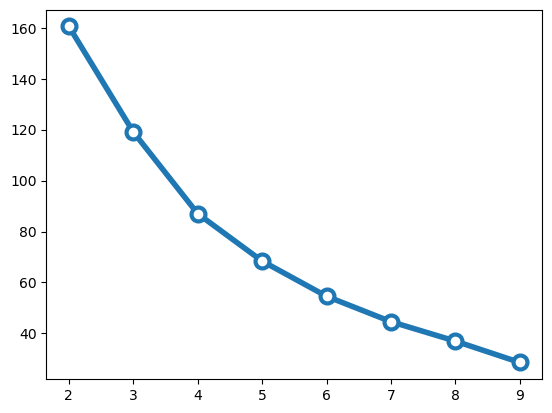

In [60]:
n_clusters = list(range(2, 10))

# Run kmeans for each value of k
inertias = []
for k in n_clusters:
    
    # Initialize and run
    kmeans = KMeans(n_clusters=k, n_init=10)
    kmeans.fit(hk_merged_scaled)
    
    # Save the "inertia"
    inertias.append(kmeans.inertia_)
    
# Plot it!
plt.plot(n_clusters, inertias, marker='o', ms=10, mfc='white', lw=4, mew=3);

This *'Kneed'* package can help us determine the 'knee' point quantitatively. It gives out the number of cluster of 4, which aligns with our initial testing and decision for Scree plot. 

In [61]:
from sklearn.cluster import KMeans
import altair as alt
from sklearn.preprocessing import MinMaxScaler, RobustScaler
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
hk_merged_scaled = scaler.fit_transform(hk_merged[['total_pop_2016', 'total_pop_2021',
       'total_pop_2011', 'median_age_2011', 'median_age_2016',
       'median_age_2021', 
       'road_density',
       'open_space_area', 'mean_temp_2011', 'mean_temp_2016', 'mean_temp_2021',
       'mean_ndvi_2011', 'mean_ndvi_2016', 'mean_ndvi_2021',
       'building_density']])
hk_merged_scaled[:5]
kmeans = KMeans(n_clusters=4, random_state=42, n_init=10)


**Scree plot** is one way to determine how many clusters we should input for our kmeans model. From the shape of the curve, we probably will select 3 or 4 for our final number of cluster. 

In [62]:
from kneed import KneeLocator

# Initialize the knee algorithm
kn = KneeLocator(n_clusters, inertias, curve='convex', direction='decreasing')

# Print out the knee 
print(kn.knee,n_clusters)

4 [2, 3, 4, 5, 6, 7, 8, 9]


After performing the kmeans analysis, we gives each district a 'label' so that we can visualize the cluster on the map. 

In [63]:
kmeans.fit(hk_merged_scaled)
hk_merged["label"] = kmeans.labels_
hk_merged.groupby('label', as_index=False).size()

,label,size
0,0,1
1,1,5
2,2,7
3,3,5


We finally plot our result as a map. It can be seen that four clusters are shown quite evenly across Hong Kong, except Cluster 0 (in **Dark Red**) which demonstrates the Hong Kong Island District with airports, few buildings, low population density, mainly mountains and high volume of vegetations). 

It demonstrates that the pale blue regions (**Cluster 2**) are remote suburb areas with relatively low population and building density, and are having large areas of parks and natural landscapes. The orange regions (**Cluster 1**) represents the main populated living area where population densities are high and buildings are dense. Dark Blue (**Cluster 3**) regions are the main business & entertainment and travel areas where there are many buildings and population, while the area is small so density is high. 

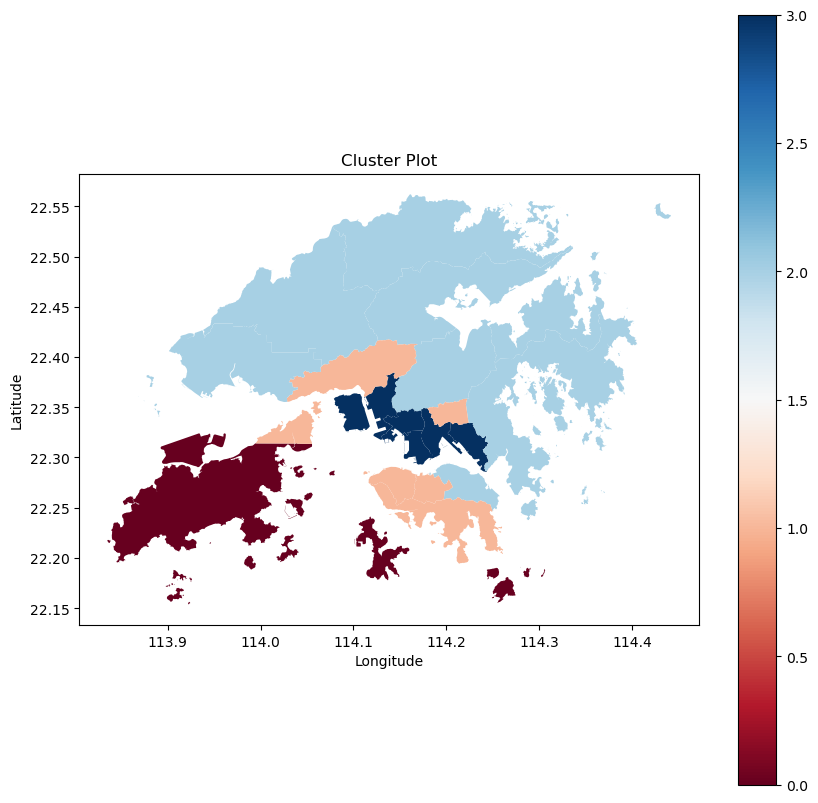

In [95]:
# plot_cluster= hk_merged.hvplot(geo=True,  # Use geographic coordinates
#                        c='label',  # Use the mean temperature column for coloring
#                        hover_cols=['CNAME'],  # Display district names on hover
#                        cmap='RdBu',  # Choose a colormap
#                        colorbar=True,  # Display a colorbar
#                        frame_width=500)  # Set the width of the frame
# plot_cluster

fig, ax = plt.subplots(figsize=(10, 10))  # Adjust the size as needed
plot_cluster = hk_merged.plot(column='label', cmap='RdBu', 
                              legend=True, ax=ax)
ax.set_title('Cluster Plot')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')

plt.show()


If we are to assign names to those clusters, the dark red (cluster 0) will be **Emergent Mixed-Use Area**, the orange (cluster 1) will be **Urban Residential Zone**, the pale blue (cluster 2) will be **Suburb Oasis**, the dark blue (cluster 3) will be **Commercial and Entertainment Hub**, which is also identifed as with high vulnerbility to future urban heat index.

## Appendix
(https://code.earthengine.google.com/531a9a4d8b3a6c1a3fafab218f7d7159). 

Navigating Data Source Challenges in Urban Heat Index Analysis
Acquiring and utilizing data for our Urban Heat Index analysis involved a series of steps and challenges, particularly in data calibration and exportation. Our primary data source was a feature collection from the Google Earth Engine (GEE), which provided us with Landsat 7 satellite imagery. We initially started with the Raw Scene version of the Landsat 7 data. This version had no calibration applied to the digital numbers, meaning the data was in its most unprocessed form.

Subsequently, we discovered the "Top of Atmosphere" (TOA) version of the Landsat 7 data, which had been converted by the US Geological Survey (USGS). This TOA version seemed promising and functioned well within the Google Earth Engine environment. However, we encountered a significant issue when exporting the data from GEE to Python. Specifically, Band 3 and Band 4 values were altered during this export process. This alteration led to the NDVI values falling outside the expected range of -1 to 1, a puzzling issue that we struggled to resolve.

To address this, we implemented cloud masks to remove the impact of cloud cover from our analysis, hoping this would correct the discrepancies in the NDVI values. Unfortunately, this step did not yield the desired results. The problem might lie in exporting the data, particularly the stage where data is transferred to Google Drive. The data, when downloaded, undergoes a zipping and unzipping process on our laptops. We hypothesized that this process could potentially alter the band values for Band 3, 4, and 6 (the Thermal Band similar to Landsat 8, Band 10, and Band 11), resulting in the discrepancies we observed.